# Лабораторная работа №2
## Продвинутые методы
***
Авторы: Заречнев Алексей, Петрасюк Алексей, Халили Алина, Галимова Ярослава (все - счастливые обитатели группы M3236)  
[Ссылка на репозиторий](https://github.com/3ELEHblE-LIJanki/Optimization-Methods-lab2)

В данной лабораторной работе нами был реализован метод Ньютона. Его можно найти в файле `newton.py` в репозитории [`lib`](https://github.com/3ELEHblE-LIJanki/Optimization-lib/tree/08f159d6b4ff8b11ee9a361be8e92b438ea8a6f8), на который ведёт сабмодуль [этого](https://github.com/3ELEHblE-LIJanki/Optimization-Methods-lab2) репозитория. Главная цель прежняя — найти точку минимума функции. Только теперь мы оперируем методом **второго порядка**, то есть нас интересует вторая производная функции. Здесь тоже всё как раньше - мы используем уже реализованные нами вспомогательные методы из `lrs.py` и классы для рисования графиков из прошлой лабораторной работы. В чём глобальное отличие?  

Если простыми словами, то градиентный спуск говорит: «Иди вниз по склону по направлению наискорейшего убывания функции», в то время как метод Ньютона несколько умнее: он не только смотрит на уклон, но и учитывает то, как быстро меняется уклон. Это напоминает стратегии выбора шага Вольфе или Гольдштейна, которые проверяли походи условия, но при этом опирались только на градиент (то есть являлись методами первого порядка). Давайте посмотрим, как это работает на практике и сравним результаты.

### Задание 1. Метод Ньютона с выбором шага и с одномерным поиском

Метод Ньютона использует вторые производные (гессиан) для учета кривизны функции. Он аппроксимирует функцию квадратичной формой и находит минимум этой аппроксимации. А как мы умеем аппроксимировать? По Тейлору!  
$f(x_k + p) = f(x_k) + grad(f(x_k)) * p + 1/2 * p^T * H(f(x_k))*p + o(x_k^{2})$    
$H$ - гессиан (иначе - матрица вторых производных или, как мы обозначали на матане, $d^2f$)  

Тогда следующий шаг будет вычисляться как $x_{k+1} = x_k + l * H^{-1}*grad(f(x_k))$  
Мы же используем функцию `boundize`, чтобы оставаться в заданных рамках, а так же в нашем случае есть `l` - learning_rate_shedule, которая по умолчанию равна 1 (в классическом методе Ньютона), но мы также можем адаптировать наш метод и превратить его в **damped Newton method**.  
Наша реализация выглядит следующим образом:

```
    def find_min(self, start, max_iterations):
        """
            :param start: List[float] - стартовая точка, в которой начнём поиск
            :param max_iterations: int - максимальное количество итераций спуска
            :return: - минимум полученный в ходе спуска
        """
        self.__init(start)
        for i in range(max_iterations):
            self.path.append(self.x)
            G = np.array(gradient(self.f, self.x, self.eps))
            if np.linalg.norm(G) <= self.eps:
                break
            H = np.array(hessian(self.f, self.x, self.eps))
            l = self.learning_rate_scheduling(self.x, i, self.f, self.bounds)
            self.x = boundize(np.array(self.x) - l * np.linalg.inv(H).dot(G), self.bounds)
    
        return self.f(self.x)
```

#### $x^2 + 10y^2$

In [49]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: x[0] ** 2 + 10 * x[1] ** 2)

func.clear()
gradient.clear()
hessian.clear()
linear_search = GradientDecent(exponential_decay(0.03, 0.001), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_1 = GraphicsPlotter(linear_search)
res_1 = linear_search.find_min([5, 3], 1000)
pretty_print(linear_search, "EXP", res_1, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([5, 3], 1000)
pretty_print(newton_cg, "NEW", res_2, gradient, hessian)

test_painter_1.plot("EXP")
test_painter_2.plot("NEWTON")


        EXP
            found result:         0.000003
            found result in:      [0.0018352656151237926, 3.764878143015935e-20]
            steps count:          138
            function calls count: 1
            gradient calls count: 138
            hessian calls count:  0
          

        NEW
            found result:         0.000000
            found result in:      (np.float64(4.1371347325735996e-07), np.float64(-1.823607931328297e-08))
            steps count:          2
            function calls count: 1
            gradient calls count: 2
            hessian calls count:  1
          


**Вывод**: на квадратичных функциях метод Ньютона работает гораздо лучше и даже точнее. Это связано с тем, что мы аппроксимируем функцию ей же самой. В теории мы должны были справиться за 1 шаг, но с учётом погрешностей при счёте здесь мы сделали два шага. Тем не менее, это в разы меньше числа шагов для градиентного спуска, например, с экспоненциальным затуханием

#### $(1 - x)^2 + 100(y-x^2)^2$ ("Банановая функция" или функция Розенброка)

Метод Ньютона может страдать от плохой обусловленности гессиана вдали от минимума. Градиентный спуск будет "зигзагообразно" медленно сходиться.  

Вдоль кривой $y = x^2$ функция сходится медленно и, как следствие, в этих точках определитель гессиана практически нулевой, что приводит нас к неточным, но при этом большим шагам. А вдали от этой кривой мы наоборот делаем слишком маленькие шаги, что приводит к увеличению их количества.   

Минимум достигается в точке (1, 1), значение - 0.

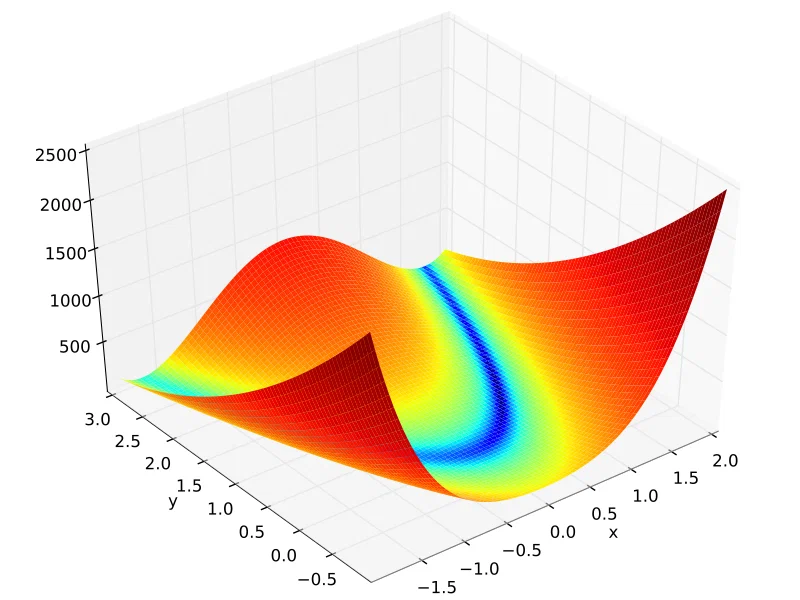

In [82]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: (1 - x[0]) ** 2 + 500 * (x[1] - x[0] ** 2) ** 2)

func.clear()
gradient.clear()
hessian.clear()
linear_search = GradientDecent(wolfe(0.0001, 0.9), func, [[-1.5, 1.5], [-1.5, 1.5]], 0.00001)
test_painter_1 = GraphicsPlotter(linear_search)
res_1 = linear_search.find_min([0, 0], 1200)
pretty_print(linear_search, "WOLFE", res_1, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-1.5, 1.5], [-1.5, 1.5]], 0.00001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([0, 0], 1200)
pretty_print(newton_cg, "NEW_GOOD", res_2, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg_3 = NewtonCG(constant(1), func, [[-1.5, 1.5], [-1.5, 1.5]], 0.00001)
# test_painter_3 = GraphicsPlotter(newton_cg_3)
res_3 = newton_cg_3.find_min([-5, 20], 1200)
pretty_print(newton_cg_3, "NEW_BAD", res_3, gradient, hessian)

test_painter_1.plot("WOLFE")
test_painter_2.plot_3d("GOOD NEWTON")
# test_painter_3.plot("BAD NEWTON")


        WOLFE
            found result:         0.062151
            found result in:      [0.7507853725061256, 0.5632950794606112]
            steps count:          1200
            function calls count: 14524
            gradient calls count: 15737
            hessian calls count:  0
          

        NEW_GOOD
            found result:         0.000000
            found result in:      (np.float64(0.9999998993574144), np.float64(0.9999997987137917))
            steps count:          4
            function calls count: 1
            gradient calls count: 4
            hessian calls count:  3
          

        NEW_BAD
            found result:         0.000000
            found result in:      (np.float64(0.9999998999999417), np.float64(0.9999997999998933))
            steps count:          53
            function calls count: 1
            gradient calls count: 53
            hessian calls count:  52
          


**Вывод:**
Алгоритм либо расходится (если шаг вдоль долины слишком большой), либо медленно движется (если гессиан регуляризован, но тогда теряется преимущество Ньютона).

### Задание 2. Сравнение с библиотекой `scipy.optimize`. Метод Newton-CG и квазиньютоновские методы

### Задание 3. Квазиньютоновский метод

### Задание 4. Библиотека `optuna` и её применение на функциях